# AgglomerativeClustering

In [1]:
import numpy as np
import sys
sys.path.append("..")
from function.real_data_function import loadData,showData,removenans, preprocessing, showDistribution, crossplot, plotResult
from function.function import subsample, ag, ag_param, plot_dimensionality_reduction, crossplot_result, plot_cluster_distribution

## Load Data

In [2]:
data_vp = np.loadtxt('../realData/P-wave_output_monte_carlo_correct.xyz')
data_vs = np.loadtxt('../realData/S-wave_output_correct.xyz')
mask = np.loadtxt('../realData/S-wave_mask.xyz')
data = loadData(data_vp,data_vs,mask)
data = subsample(data,3)

## Plot Input Data

Using function show_data() to draw each parameter of input data. 

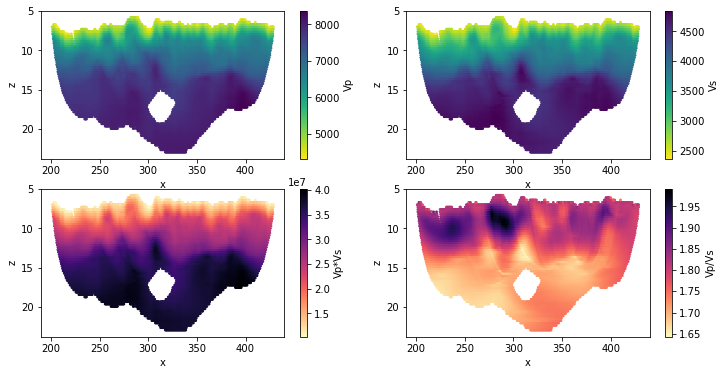

In [3]:
showData(data)

Using removenans() to remove points with nan values from array. 

- new_data is the original data saved in the form of np.array.

- data_noNan removes nan values from new_data. 

- nan_list is the list of nan values index.

In [4]:
data_noNan,nan_list = removenans(data)

Using showDistribution() to show the distribution of each parameter(except x and z)

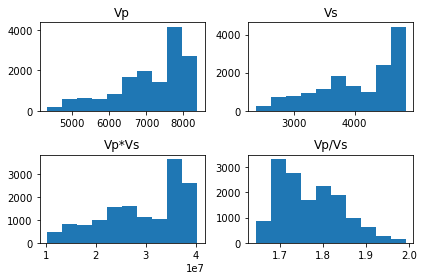

In [5]:
showDistribution(data)

Using crossplot to plot the cross-plot (scatter plot) of each pair of physical properties (other parameters and vp)

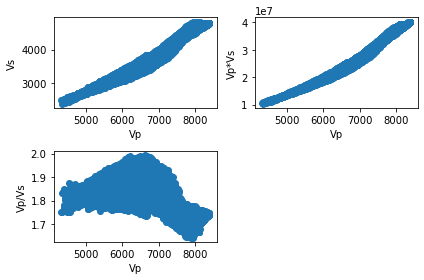

In [6]:
crossplot(data)

## Data Preprocessing

Using preprocessing() to make data standardized

In [7]:
# remove the mean
# divide by the variance

data_preprocessing = preprocessing(data_noNan) 


## Plot Data after Preprocessing

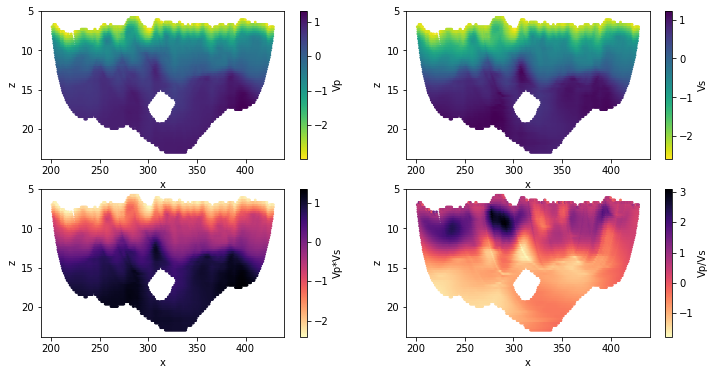

In [8]:
showData(data_preprocessing)

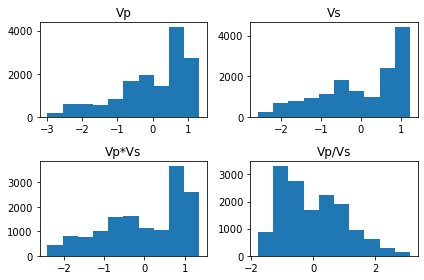

In [9]:
showDistribution(data_preprocessing)

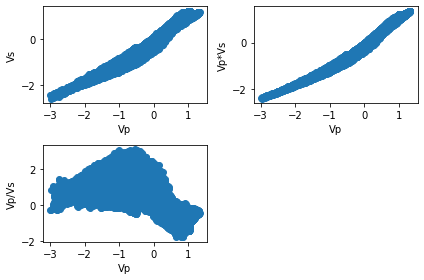

In [10]:
crossplot(data_preprocessing)

## AgglomerativeClustering

Using ag() to divide data in clusters.

- result_ag is the result of AgglomerativeClustering and data_preprocessing is normalized data without nan values

Using plotResult() to show the result of clusters.

- data_noNan removes nan values from original data
- result_ag is labels for data without nan values after AgglomerativeClustering

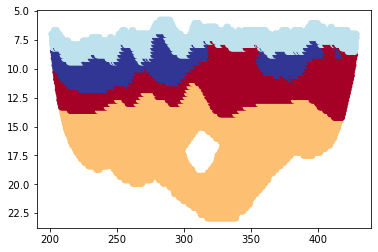

In [11]:
result_ag = ag(4,data_preprocessing[:,:-2])
plotResult(data_noNan,result_ag)

## Tuning Parameters

Using ag_param to find optimal parameters.

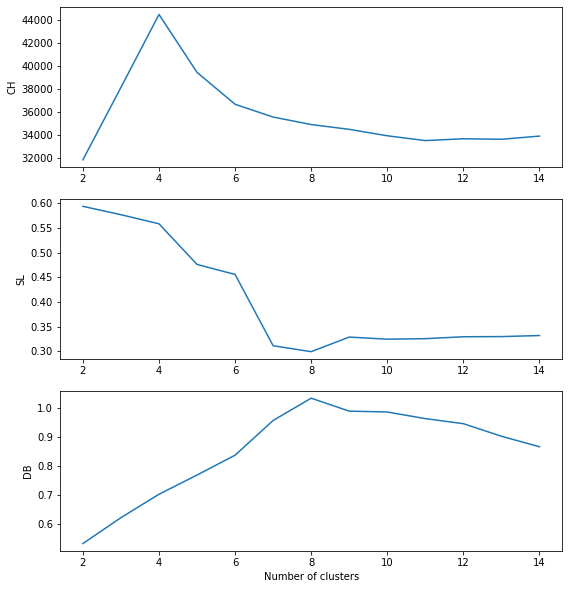

In [12]:
ag_param(data_preprocessing[:,:-2])

## Choosing Parameters

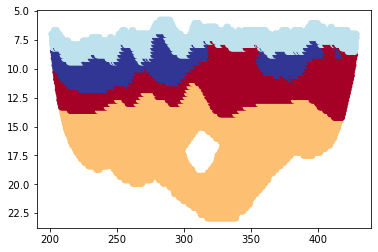

In [13]:
result_ag = ag(4,data_preprocessing[:,:-2])
plotResult(data_noNan,result_ag)

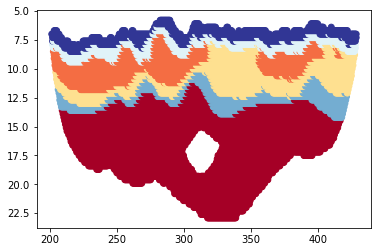

In [14]:
result_ag = ag(6,data_preprocessing[:,:-2])
plotResult(data_noNan,result_ag)

## Optimal Result

In [15]:
result_ag = ag(6,data_preprocessing[:,:-2])

## Dimensionality Reduction

Using plot_dimensionality_reduction() to plot the cluster result after dimensionality reduction.

It has two parameters:

- The first one is dataset
- The second one is cluster result

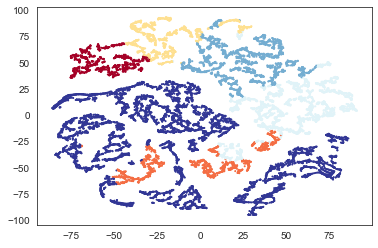

In [16]:
plot_dimensionality_reduction(data_preprocessing[:,:-2],result_ag)

## Result Crossplot

crossplot_result has two parameters.
- The first one is dataset with no nan values.
- The second one is clustering result.

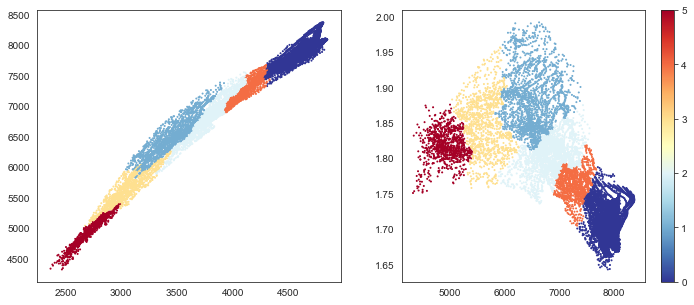

In [17]:
crossplot_result(data_noNan, result_ag)

## Cluster Distribution

Using plot_cluster_distribution() to plot the distribution of clusters.

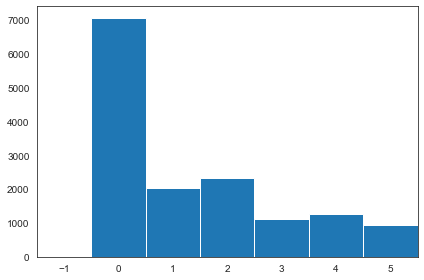

In [18]:
plot_cluster_distribution(result_ag)